In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!nvidia-smi

Sat Aug 20 00:05:21 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import numpy as np
import pandas as pd
import tensorflow
#import keras
from tensorflow import keras
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, Activation, Dropout, Conv1D, MaxPooling1D, Flatten
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier
#from tensorflow.keras.utils import np_utils
#from keras.optimizers import SGD
#import keras.optimizers
from tensorflow.keras import regularizers, initializers

from sklearn.model_selection import cross_val_score, KFold, train_test_split, GridSearchCV
from sklearn.preprocessing import LabelEncoder, StandardScaler, OneHotEncoder
from sklearn.pipeline import Pipeline
#from sklearn import svm, metrics
from sklearn.metrics import confusion_matrix
#from sklearn.naive_bayes import GaussianNB
#from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier

import matplotlib.pyplot as plt
import seaborn as sns
#import itertools
#from skimage.feature import greycomatrix, greycoprops
#from multiprocessing import Pool
#from scipy import stats
#from skimage import io

In [ ]:
final = pd.read_csv("/content/drive/MyDrive/App/data/final.csv")
final.head()

,col_0,col_1,col_2,col_3,col_4,col_5
0,6064.0,5403.0,4220.0,4761.0,8783.0,1
1,4826.0,3924.0,2126.0,3392.0,10584.0,1
2,5019.0,4113.0,2256.0,3494.0,12557.0,1
3,4907.0,4264.0,2104.0,3747.0,12208.0,1
4,5025.0,4223.0,2369.0,3623.0,12140.0,1


In [ ]:
labels = final.iloc[:,-1]
data = final.drop(final.columns[5],axis=1)

There are 3 models (SVM, Random Forest and Netural Network (NN)) and here I only tested NN against samples. Meanwhile, NN was trained on AutoDL plateform with RTX 3090 GPU. Here I loaded the .h5 model file to save computation time. 

In [ ]:
# encode class values as integers
encoder = LabelEncoder()
encoder.fit(labels)
encoded_Y = encoder.transform(labels)

# convert y (integer 1,3,5) to dummy variables (i.e. one hot encoded)
dummy_y = keras.utils.to_categorical(encoded_Y)

# 80% for training, 20% for test
X_train, X_test, y_train, y_test = train_test_split(data, dummy_y, test_size=0.2, random_state=42,shuffle = True)

# standardize x
sc_X = StandardScaler()
X_train = sc_X.fit_transform(X_train)
X_test = sc_X.transform(X_test)

print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(48000000, 5) (48000000, 3)
(12000000, 5) (12000000, 3)


In [ ]:
## another set of x, y for SVM, RandomForest
X_train2, X_test2, y_train2, y_test2  = train_test_split(data.values, labels.values, test_size=0.2, random_state=42)
sc_X = StandardScaler()
X_train2 = sc_X.fit_transform(X_train2)
X_test2 = sc_X.transform(X_test2)

In [ ]:
print("Training data: ", len(X_train2) , " Training Labels: ", len(y_train2))
print("Testing data: ", len(X_test2), " Testing Labels: ", len(y_test2) )
print("Sample size is: ", X_train2[0].shape)

Training data:  48000000  Training Labels:  48000000
Testing data:  12000000  Testing Labels:  12000000
Sample size is:  (5,)


In [ ]:
def plots(history):
  plt.subplot(1,2,1)
  loss=history.history['loss']
  val_loss = history.history['val_loss']
  epochs = range(1, len(loss)+1)
  plt.plot(epochs, loss, "bo", label='Training loss')
  plt.plot(epochs, val_loss, 'b', label='Validation loss')
  plt.title('Training and Validation Loss')
  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.legend()

  plt.subplot(1,2,2)
  acc=history.history['acc']
  val_acc = history.history['val_acc']
  plt.plot(epochs, acc, "bo", label='Training accuracy')
  plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
  plt.title('Training and Validation Accuracy')
  plt.xlabel('Epochs')
  plt.ylabel('Accuracy')
  plt.legend()
  plt.show()

In [ ]:
## Model 1: neural network 
def nnModel(X_train, X_test, y_train, y_test):
  seed = 7
  np.random.seed(seed)

  model = Sequential()
  model.add(Dense(800, input_shape=(5, ), activation='relu',kernel_regularizer=regularizers.l2(1e-5),kernel_initializer=keras.initializers.glorot_normal(seed=seed),bias_initializer='zeros'))
  model.add(Dropout(0.5))
  model.add(Dense(800, activation='relu',kernel_regularizer=regularizers.l2(1e-5),kernel_initializer=keras.initializers.glorot_normal(seed=seed),bias_initializer='zeros'))
  model.add(Dropout(0.5))
  model.add(Dense(800, activation='relu',kernel_regularizer=regularizers.l2(1e-5),kernel_initializer=keras.initializers.glorot_normal(seed=seed),bias_initializer='zeros'))model.add(Dropout(0.5))
  model.add(Dense(3, activation='softmax'))
  model.summary()

  sgd = keras.optimizers.Adadelta()
  model.compile(loss='categorical_crossentropy',
              optimizer=sgd,
              metrics=['acc'])
  history = model.fit(X_train, y_train,
                      epochs=10,
                      batch_size=100,
                      shuffle=True,
                      validation_data=(X_test, y_test))
  plots(history)
#  score = model.evaluate(X_test, y_test, batch_size=100)
#  print("\n%s: %.2f%%" % (model.metrics_names[1], score[1]*100))

In [ ]:
## Model 2: Random Forest
def randomForestModel(X_train, y_train, X_test, y_test):    
    rf = RandomForestClassifier(n_estimators = 600, max_depth=300, max_features="sqrt", random_state = 0)
    rf.fit(X_train, y_train)   
    predictions = rf.predict(X_test)           
    print("The accuracy of the random forest classifier is: " + str(metrics.accuracy_score(y_test, predictions)))
    print("\n\nClassification report of random forest classifier is - \n{}\n".format(
        metrics.classification_report(y_test, predictions, zero_division=0)))
    

In [ ]:
## Model 2: CNN 
def CNNModel(X_train, X_test, y_train, y_test):
  model = Sequential()
  model.add(Conv1D(kernel_size = 2, strides=1,filters = 32, activation='relu',input_shape=(5,1))) 
  model.add(MaxPooling1D(pool_size = (2), strides=(2)))
  model.add(Conv1D (kernel_size = 2, strides=1, filters = 64, activation='relu'))
  model.add(MaxPooling1D(pool_size = (2), strides=(2)))
  model.add(Flatten())
  model.add(Dense (1000, activation='relu'))
  model.add(Dense(3, activation = 'softmax'))
  history=model.compile(loss='categorical_crossentropy', optimizer=keras.optimizers.Adam(lr=0.001),metrics=['accuracy'])
  plots(history)

In [ ]:
## run models. But here I loaded model instead of running on colab
softmaxModel(X_train, X_test, y_train, y_test) 

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 300)               1800      
                                                                 
 dropout (Dropout)           (None, 300)               0         
                                                                 
 dense_1 (Dense)             (None, 3)                 903       
                                                                 
Total params: 2,703
Trainable params: 2,703
Non-trainable params: 0
_________________________________________________________________
Epoch 1/10
480000/480000 [==============================] - 1295s 3ms/step - loss: 0.6771 - acc: 0.7490 - val_loss: 0.5942 - val_acc: 0.7931
Epoch 2/10
480000/480000 [==============================] - 1060s 2ms/step - loss: 0.5915 - acc: 0.7935 - val_loss: 0.5715 - val_acc: 0.7996
Epoch 3/10
480000/480000 [==========

In [ ]:
#randomForestModel(X_train2, y_train2, X_test2, y_test2)
#CNNModel(X_train, X_test, y_train, y_test)

In [ ]:
model = load_model('/content/drive/MyDrive/App/data/cropClassifier.h5')
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 800)               4800      
                                                                 
 dropout (Dropout)           (None, 800)               0         
                                                                 
 dense_1 (Dense)             (None, 800)               640800    
                                                                 
 dropout_1 (Dropout)         (None, 800)               0         
                                                                 
 dense_2 (Dense)             (None, 800)               640800    
                                                                 
 dropout_2 (Dropout)         (None, 800)               0         
                                                                 
 dense_3 (Dense)             (None, 3)                 2

In [ ]:
y_pred = model.predict(X_test, batch_size=1000)

## convert onehot to integers
y_test1 = np.argmax(y_test, axis=1) 
y_pred1 = np.argmax(y_pred, axis=1)

Text(0.5, 1.0, 'confusion matrix')

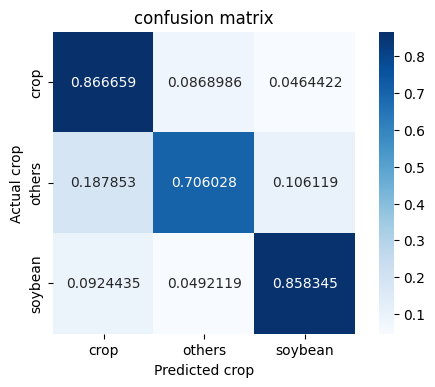

In [ ]:
confusion = confusion_matrix(y_test1, y_pred1, normalize='true')
plt.figure(dpi=100)
sns.heatmap(confusion, cmap=plt.cm.Blues, annot=True, square=True, fmt='g',
            xticklabels=['crop','others','soybean'],
            yticklabels=['crop','others','soybean'])

plt.xlabel('Predicted crop')
plt.ylabel('Actual crop')
plt.title('confusion matrix')

In [ ]:
! pip install rasterio
import rasterio

cdl_ds = rasterio.open('./drive/MyDrive/App/data/out_cdl.tif')
cdl=cdl_ds.read(1)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
classes = np.unique(cdl)
nClasses = np.setdiff1d(classes, [1,5])

nCdl=cdl
for c in nClasses:
  nCdl[cdl==c]=3  # set other classes as class 3

In [ ]:
data_ds = rasterio.open('/content/drive/MyDrive/App/data/RapidEye.tif')
img_data = data_ds.read()
print(img_data.shape)
img_d = np.reshape(img_data, (5,11652*9210))
sc_X = StandardScaler()
X=sc_X.fit_transform(img_d.T)

(5, 11652, 9210)


In [ ]:
 y= model.predict(X, batch_size=1000)

In [ ]:
## convert onehot to integers
cdl_new = np.argmax(y, axis=1)
cdl_new = np.reshape(cdl_new, (11652,9210))

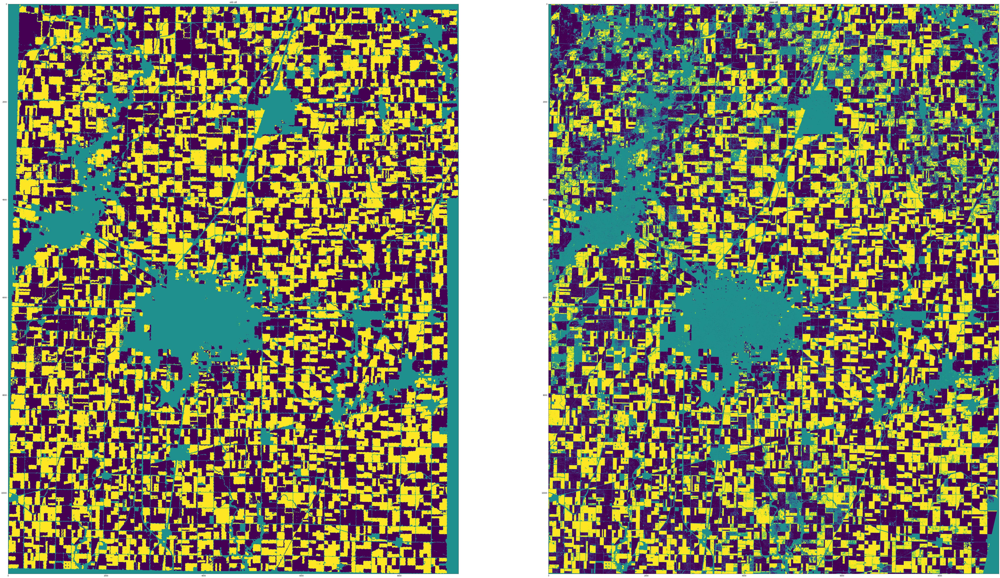

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['figure.figsize'] = [100, 100]

plt.subplot(121)
plt.imshow(nCdl)
plt.title('old cdl')

plt.subplot(122)
plt.imshow(cdl_new)#, cmap=plt.cm.Spectral)
plt.title('new cdl')

plt.show()